In [250]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re

## Read Data

In [251]:
path = "D:\CSE BRACU\CSE422\CSE422-Artificial-Intelligence-Project\FIFA23 Official dataset\FIFA23_official_data.csv"
data_fifa23 = pd.read_csv(path)
data_fifa23.head(5)

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,...,Real Face,Position,Joined,Loaned From,Contract Valid Until,Height,Weight,Release Clause,Kit Number,Best Overall Rating
0,209658,L. Goretzka,27,https://cdn.sofifa.net/players/209/658/23_60.png,Germany,https://cdn.sofifa.net/flags/de.png,87,88,FC Bayern München,https://cdn.sofifa.net/teams/21/30.png,...,Yes,"<span class=""pos pos28"">SUB",1-Jul-18,NaN,2026,189cm,82kg,€157M,8.0,NaN
1,212198,Bruno Fernandes,27,https://cdn.sofifa.net/players/212/198/23_60.png,Portugal,https://cdn.sofifa.net/flags/pt.png,86,87,Manchester United,https://cdn.sofifa.net/teams/11/30.png,...,Yes,"<span class=""pos pos15"">LCM",30-Jan-20,NaN,2026,179cm,69kg,€155M,8.0,NaN
2,224334,M. Acuña,30,https://cdn.sofifa.net/players/224/334/23_60.png,Argentina,https://cdn.sofifa.net/flags/ar.png,85,85,Sevilla FC,https://cdn.sofifa.net/teams/481/30.png,...,No,"<span class=""pos pos7"">LB",14-Sep-20,NaN,2024,172cm,69kg,€97.7M,19.0,NaN
3,192985,K. De Bruyne,31,https://cdn.sofifa.net/players/192/985/23_60.png,Belgium,https://cdn.sofifa.net/flags/be.png,91,91,Manchester City,https://cdn.sofifa.net/teams/10/30.png,...,Yes,"<span class=""pos pos13"">RCM",30-Aug-15,NaN,2025,181cm,70kg,€198.9M,17.0,NaN
4,224232,N. Barella,25,https://cdn.sofifa.net/players/224/232/23_60.png,Italy,https://cdn.sofifa.net/flags/it.png,86,89,Inter,https://cdn.sofifa.net/teams/44/30.png,...,Yes,"<span class=""pos pos13"">RCM",1-Sep-20,NaN,2026,172cm,68kg,€154.4M,23.0,NaN


## Data PreProcessing

In [252]:
data_fifa23.shape

(17660, 29)

In [253]:
data_fifa23.columns

Index(['ID', 'Name', 'Age', 'Photo', 'Nationality', 'Flag', 'Overall',
       'Potential', 'Club', 'Club Logo', 'Value', 'Wage', 'Special',
       'Preferred Foot', 'International Reputation', 'Weak Foot',
       'Skill Moves', 'Work Rate', 'Body Type', 'Real Face', 'Position',
       'Joined', 'Loaned From', 'Contract Valid Until', 'Height', 'Weight',
       'Release Clause', 'Kit Number', 'Best Overall Rating'],
      dtype='object')

In [254]:
data_fifa23.dtypes

ID                            int64
Name                         object
Age                           int64
Photo                        object
Nationality                  object
Flag                         object
Overall                       int64
Potential                     int64
Club                         object
Club Logo                    object
Value                        object
Wage                         object
Special                       int64
Preferred Foot               object
International Reputation      int64
Weak Foot                     int64
Skill Moves                   int64
Work Rate                    object
Body Type                    object
Real Face                    object
Position                     object
Joined                       object
Loaned From                  object
Contract Valid Until         object
Height                       object
Weight                       object
Release Clause               object
Kit Number                  

In [255]:
data_fifa23.isnull().sum()

ID                              0
Name                            0
Age                             0
Photo                           0
Nationality                     0
Flag                            0
Overall                         0
Potential                       0
Club                          211
Club Logo                       0
Value                           0
Wage                            0
Special                         0
Preferred Foot                  0
International Reputation        0
Weak Foot                       0
Skill Moves                     0
Work Rate                       0
Body Type                      38
Real Face                      38
Position                       35
Joined                       1098
Loaned From                 16966
Contract Valid Until          361
Height                          0
Weight                          0
Release Clause               1151
Kit Number                     35
Best Overall Rating         17639
dtype: int64

In [256]:
data_fifa23_copy = data_fifa23.copy()

In [257]:
# Convert the difference of 'Joined' and 'Contract Valid Until'
data_fifa23_copy['Contract Duration'] = 0.0
data_fifa23_copy['Joined'] = pd.to_datetime(data_fifa23_copy['Joined']).dt.year

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\4027583713.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  data_fifa23_copy['Joined'] = pd.to_datetime(data_fifa23_copy['Joined']).dt.year


In [258]:
for i in range(0,len(data_fifa23_copy['Contract Duration'])):
    if pd.isna(data_fifa23_copy['Joined'][i]) == False:
        duration = abs(data_fifa23_copy['Joined'][i] - int(data_fifa23_copy['Contract Valid Until'][i]))
        data_fifa23_copy['Contract Duration'][i] = duration

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1854718832.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_fifa23_copy['Contract Duration'][i] = duration
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1854718832.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_fifa23_copy['Contract Duration'][i] = duration
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1854718832.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-

In [259]:
data_fifa23_copy['Contract Duration']

0         8.0
1         6.0
2         4.0
3        10.0
4         6.0
         ... 
17655     5.0
17656     4.0
17657     2.0
17658     1.0
17659     1.0
Name: Contract Duration, Length: 17660, dtype: float64

In [260]:
# drop unnecessary column 
to_drop = ['ID', 'Name', 'Photo', 'Flag', 'Club Logo', 'Real Face', 'Joined', 'Contract Valid Until','Loaned From', 'Best Overall Rating']
data_fifa23_copy.drop(columns=to_drop, inplace=True)

In [261]:
# Split the 'Work Rate' column
data_fifa23_copy['att work rate'] = pd.NA
data_fifa23_copy['def work rate'] = pd.NA
for i in range(len(data_fifa23_copy['Work Rate'])):
    tup = data_fifa23_copy['Work Rate'][i].split('/')
    data_fifa23_copy['att work rate'][i] = tup[0]
    data_fifa23_copy['def work rate'][i] = tup[1]


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1394437161.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_fifa23_copy['att work rate'][i] = tup[0]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1394437161.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_fifa23_copy['def work rate'][i] = tup[1]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\1394437161.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_

In [262]:
data_fifa23_copy['att work rate']

0          High
1          High
2          High
3          High
4          High
          ...  
17655    Medium
17656    Medium
17657    Medium
17658    Medium
17659    Medium
Name: att work rate, Length: 17660, dtype: object

In [263]:
# Value, Wage and Release Clause is price
def convert_price(column):
    for i in range(len(column)):
        if pd.isna(column[i]) == False:
            lst_idx = column[i][-1]
            if lst_idx == '0':
                column[i] = 0.0
            else:
                price = float(column[i][1:-1])
                if lst_idx == 'M':
                    column[i] = price * 1000000
                elif lst_idx == 'K':
                    column[i] = price * 1000
        else:
            column[i] = 0.0
    return column

data_fifa23_copy['Value'] = convert_price(data_fifa23_copy['Value'])
data_fifa23_copy['Wage'] = convert_price(data_fifa23_copy['Wage'])
data_fifa23_copy['Release Clause'] = convert_price(data_fifa23_copy['Release Clause'])

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\L

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_18576\2162759000.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[i] = price * 1000000
C:\Users\L

In [264]:
data_fifa23_copy['Value']

0         91000000.0
1         78500000.0
2         46500000.0
3        107500000.0
4         89500000.0
            ...     
17655       100000.0
17656       100000.0
17657        70000.0
17658        90000.0
17659        90000.0
Name: Value, Length: 17660, dtype: object

In [265]:
data_fifa23_copy['Release Clause']

0        157000000.0
1        155000000.0
2         97700000.0
3        198900000.0
4        154400000.0
            ...     
17655       218000.0
17656       188000.0
17657       142000.0
17658       214000.0
17659       131000.0
Name: Release Clause, Length: 17660, dtype: object

In [266]:
# Handle height and weight
data_fifa23_copy['Height'] = data_fifa23_copy['Height'].str.replace('cm', '').astype(float)
data_fifa23_copy['Weight'] = data_fifa23_copy['Weight'].str.replace('kg', '').astype(float)

In [267]:
data_fifa23_copy['Height']

0        189.0
1        179.0
2        172.0
3        181.0
4        172.0
         ...  
17655    190.0
17656    195.0
17657    190.0
17658    187.0
17659    186.0
Name: Height, Length: 17660, dtype: float64

In [268]:
# handle Position column
data_fifa23_copy['Position'] = data_fifa23_copy['Position'].apply(lambda x: re.sub(r'<.*?>', '', x))

TypeError: expected string or bytes-like object, got 'float'

In [ ]:
data_fifa23_copy['Position']

0        <span class="pos pos28">SUB
1        <span class="pos pos15">LCM
2          <span class="pos pos7">LB
3        <span class="pos pos13">RCM
4        <span class="pos pos13">RCM
                    ...             
17655    <span class="pos pos29">RES
17656    <span class="pos pos29">RES
17657    <span class="pos pos29">RES
17658    <span class="pos pos29">RES
17659    <span class="pos pos29">RES
Name: Position, Length: 17660, dtype: object

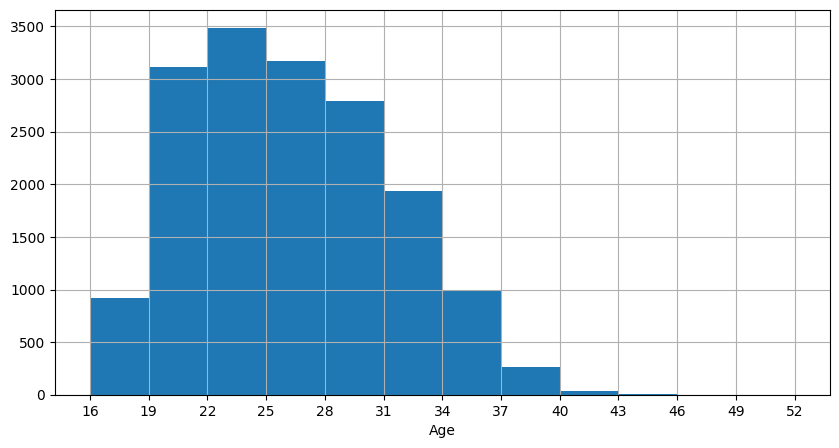

In [ ]:
# Setup bins
no_bins = 10
min_bin_value = int(df['Age'].min())
max_bin_value = int(df['Age'].max()) + 1
no_data_points = df.shape[0]
predefined_bins = list(range(min_bin_value,max_bin_value,int((max_bin_value-min_bin_value)/no_bins)))

# Create the histogram
df['Age'].hist(bins=predefined_bins, figsize=(10,5))

# Now let's setup the labels, titles and format y axis as percentages
plt.xlabel('Age')
plt.xticks(predefined_bins)
plt.show()

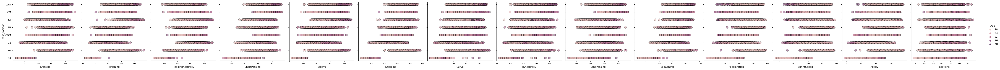

In [ ]:
cols_to_plot = ['Crossing','Finishing','HeadingAccuracy','ShortPassing','Volleys',
                'Dribbling','Curve','FKAccuracy','LongPassing','BallControl',
                'Acceleration','SprintSpeed','Agility','Reactions']

sns.pairplot(data=df,
                  y_vars=['Best_Position'],
                  x_vars=cols_to_plot,
                  hue='Age',
                  plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
                  height=4)

In [ ]:
# cols_to_plot = ['Crossing','Finishing','HeadingAccuracy','ShortPassing','Volleys',
#                 'Dribbling','Curve','FKAccuracy','LongPassing','BallControl',
#                 'Acceleration','SprintSpeed','Agility','Reactions']

# sns.pairplot(data=final_df,
#                   y_vars=['Best_Position'],
#                   x_vars=cols_to_plot,
#                   hue='Age',
#                   plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
#                   height=4)

<Axes: >

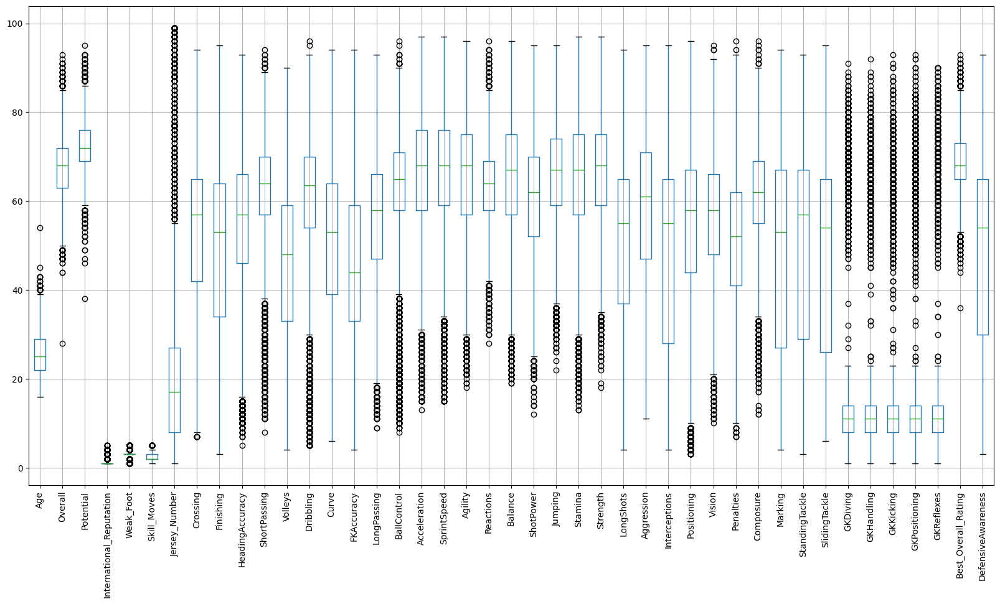

In [ ]:
df.boxplot(rot=90, figsize=(20,10))

In [ ]:
# final_df.drop(columns=["Value", "Wage"]).boxplot(rot=90, figsize=(20,10))

In [ ]:
df[df["BallControl"] < 40]["Best_Position"].value_counts()

Best_Position
GK    1533
CB     140
FB      15
WI       2
ST       1
Name: count, dtype: int64

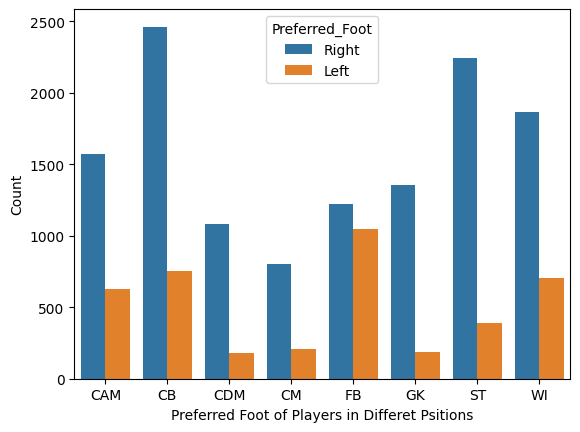

In [ ]:
dft = df.groupby("Best_Position")["Preferred_Foot"].value_counts().reset_index(name='Count')

p = sns.barplot(x='Best_Position', y='Count', data=dft, hue='Preferred_Foot')
p.legend(title='Preferred_Foot')
p.set(xlabel='Preferred Foot of Players in Differet Psitions')
import matplotlib.patches as mpatches
# dft

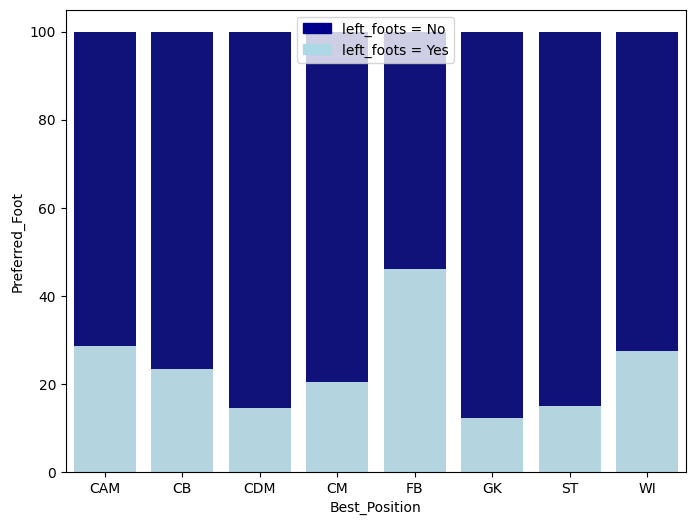

In [ ]:
import matplotlib.patches as mpatches


plt.figure(figsize=(8, 6))

# from raw value to percentage
total = df.groupby('Best_Position')['Preferred_Foot'].count().reset_index()
left_foots = df[df.Preferred_Foot=='Left'].groupby('Best_Position')['Preferred_Foot'].count().reset_index()
left_foots['Preferred_Foot'] = [i / j * 100 for i,j in zip(left_foots['Preferred_Foot'], total['Preferred_Foot'])]
total['Preferred_Foot'] = [i / j * 100 for i,j in zip(total['Preferred_Foot'], total['Preferred_Foot'])]

# bar chart 1 -> top bars (group of 'left_foots=No')
bar1 = sns.barplot(x="Best_Position",  y="Preferred_Foot", data=total, color='darkblue')

# bar chart 2 -> bottom bars (group of 'left_foots=Yes')
bar2 = sns.barplot(x="Best_Position", y="Preferred_Foot", data=left_foots, color='lightblue')

# add legend
top_bar = mpatches.Patch(color='darkblue', label='left_foots = No')
bottom_bar = mpatches.Patch(color='lightblue', label='left_foots = Yes')
plt.legend(handles=[top_bar, bottom_bar])

# # show the graph
plt.show()
# left_foots.head()

In [ ]:
df.groupby("Best_Position")["Age"].mean()


Best_Position
CAM    23.941897
CB     26.252645
CDM    26.920761
CM     26.327399
FB     25.548060
GK     27.108021
ST     25.925504
WI     24.905631
Name: Age, dtype: float64

In [ ]:
for col_name in list(df.columns):
    no_null_values = sum(df[col_name].isnull())
    if no_null_values:
        print('Number of null values in column %s is %d' %(col_name,no_null_values))

Number of null values in column Club is 264
Number of null values in column Body_Type is 29
Number of null values in column Jersey_Number is 26
Number of null values in column Joined is 1512
Number of null values in column Contract_Valid_Until is 351
Number of null values in column Volleys is 37
Number of null values in column Curve is 37
Number of null values in column Agility is 37
Number of null values in column Balance is 37
Number of null values in column Jumping is 37
Number of null values in column Interceptions is 8
Number of null values in column Positioning is 8
Number of null values in column Vision is 37
Number of null values in column Composure is 251
Number of null values in column Marking is 15818
Number of null values in column SlidingTackle is 37
Number of null values in column Release_Clause is 1749
Number of null values in column DefensiveAwareness is 892


In [ ]:
df[df['Agility'].isnull()]

,Age,Nationality,Overall,Potential,Club,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Work_Rate,Body_Type,Jersey_Number,Joined,Contract_Valid_Until,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,Release_Clause,DefensiveAwareness
7976,32,Netherlands,87,90,111648,€0,€0,Right,4.0,3.0,1.0,N/A/ N/A,Normal (170-185),9.0,NaN,NaN,187cm,82kg,70.0,90.0,88.0,75.0,NaN,81.0,NaN,70.0,55.0,87.0,85.0,85.0,NaN,96.0,NaN,95.0,NaN,78.0,84.0,80.0,75.0,91.0,95.0,NaN,77.0,NaN,29.0,47.0,NaN,7.0,20.0,55.0,20.0,20.0,ST,89.0,NaN,NaN
9695,37,Brazil,83,88,AC Milan,€0,€0,Right,4.0,3.0,1.0,N/A/ N/A,NaN,2.0,NaN,2007,176cm,75kg,85.0,22.0,81.0,82.0,NaN,82.0,NaN,61.0,59.0,85.0,82.0,79.0,NaN,69.0,NaN,61.0,NaN,91.0,55.0,59.0,70.0,90.0,83.0,NaN,92.0,NaN,89.0,85.0,NaN,13.0,22.0,59.0,22.0,22.0,ST,86.0,NaN,NaN
10673,30,Netherlands,81,81,LOSC Lille,€0,€0,Right,3.0,4.0,1.0,N/A/ N/A,NaN,9.0,NaN,2007,189cm,80kg,67.0,85.0,82.0,80.0,NaN,78.0,NaN,68.0,68.0,84.0,84.0,79.0,NaN,70.0,NaN,78.0,NaN,75.0,84.0,75.0,77.0,75.0,76.0,NaN,77.0,NaN,38.0,29.0,NaN,9.0,22.0,68.0,22.0,22.0,ST,81.0,NaN,NaN
10700,31,Uruguay,86,87,Torino F.C.,€0,€0,Left,2.0,4.0,1.0,N/A/ N/A,NaN,4.0,NaN,2007,179cm,79kg,55.0,82.0,62.0,84.0,NaN,92.0,NaN,92.0,66.0,88.0,77.0,86.0,NaN,71.0,NaN,91.0,NaN,72.0,82.0,93.0,84.0,78.0,67.0,NaN,64.0,NaN,22.0,23.0,NaN,6.0,22.0,66.0,22.0,22.0,ST,86.0,NaN,NaN
10993,35,Portugal,78,86,Inter,€0,€0,Right,5.0,4.0,1.0,N/A/ N/A,Normal (170-185),7.0,NaN,2009,180cm,75kg,83.0,72.0,54.0,84.0,NaN,81.0,NaN,83.0,76.0,85.0,73.0,74.0,NaN,71.0,NaN,81.0,NaN,65.0,71.0,79.0,73.0,82.0,82.0,NaN,82.0,NaN,27.0,41.0,NaN,6.0,22.0,76.0,22.0,22.0,ST,81.0,NaN,NaN
11062,33,Brazil,82,84,FC Schalke 04,€0,€0,Left,3.0,4.0,1.0,N/A/ N/A,NaN,5.0,NaN,2011,189cm,90kg,54.0,37.0,86.0,66.0,NaN,53.0,NaN,77.0,72.0,71.0,55.0,59.0,NaN,76.0,NaN,88.0,NaN,72.0,90.0,71.0,87.0,79.0,80.0,NaN,80.0,NaN,81.0,85.0,NaN,6.0,21.0,72.0,21.0,21.0,CB,83.0,NaN,NaN
11881,33,United States,76,80,New York Red Bulls,€0,€0,Right,2.0,4.0,1.0,N/A/ N/A,NaN,10.0,NaN,2009,178cm,71kg,60.0,62.0,66.0,83.0,NaN,66.0,NaN,74.0,74.0,79.0,65.0,64.0,NaN,60.0,NaN,73.0,NaN,80.0,72.0,69.0,69.0,81.0,70.0,NaN,78.0,NaN,71.0,68.0,NaN,8.0,21.0,74.0,21.0,21.0,CM,77.0,NaN,NaN
12216,35,France,83,87,FC Barcelona,€0,€0,Right,4.0,3.0,1.0,N/A/ N/A,NaN,21.0,NaN,2008,185cm,79kg,67.0,21.0,84.0,71.0,NaN,63.0,NaN,43.0,55.0,78.0,78.0,73.0,NaN,85.0,NaN,44.0,NaN,71.0,90.0,27.0,87.0,90.0,86.0,NaN,89.0,NaN,82.0,85.0,NaN,8.0,21.0,55.0,21.0,21.0,CB,83.0,NaN,NaN
12233,36,Italy,79,83,Siena,€0,€0,Left,3.0,4.0,1.0,N/A/ N/A,NaN,10.0,NaN,2007,176cm,70kg,68.0,81.0,59.0,68.0,NaN,73.0,NaN,87.0,52.0,85.0,72.0,64.0,NaN,74.0,NaN,83.0,NaN,70.0,67.0,76.0,64.0,76.0,74.0,NaN,72.0,NaN,50.0,53.0,NaN,8.0,21.0,52.0,21.0,21.0,ST,79.0,NaN,NaN
12247,33,Brazil,75,85,NaN,€0,€0,Right,3.0,3.0,1.0,N/A/ N/A,NaN,NaN,NaN,NaN,184cm,89kg,70.0,40.0,76.0,78.0,NaN,65.0,NaN,57.0,74.0,77.0,59.0,65.0,NaN,64.0,NaN,62.0,NaN,49.0,78.0,63.0,84.0,88.0,87.0,NaN,76.0,NaN,75.0,79.0,NaN,7.0,22.0,74.0,22.0,22.0,CDM,75.0,NaN,NaN


## Data PreProcessing

In [ ]:
df.drop(columns=['Marking', 'Release_Clause', 'Club', 'Joined', 'Contract_Valid_Until'], inplace=True)

In [ ]:
for col_name in list(df.columns):
    no_null_values = sum(df[col_name].isnull())
    if no_null_values:
        print('Number of null values in column %s is %d' %(col_name,no_null_values))

Number of null values in column Body_Type is 29
Number of null values in column Jersey_Number is 26
Number of null values in column Volleys is 37
Number of null values in column Curve is 37
Number of null values in column Agility is 37
Number of null values in column Balance is 37
Number of null values in column Jumping is 37
Number of null values in column Interceptions is 8
Number of null values in column Positioning is 8
Number of null values in column Vision is 37
Number of null values in column Composure is 251
Number of null values in column SlidingTackle is 37
Number of null values in column DefensiveAwareness is 892


In [ ]:
df.dropna(ignore_index=True, inplace=True)

In [ ]:
df.shape

(15802, 51)

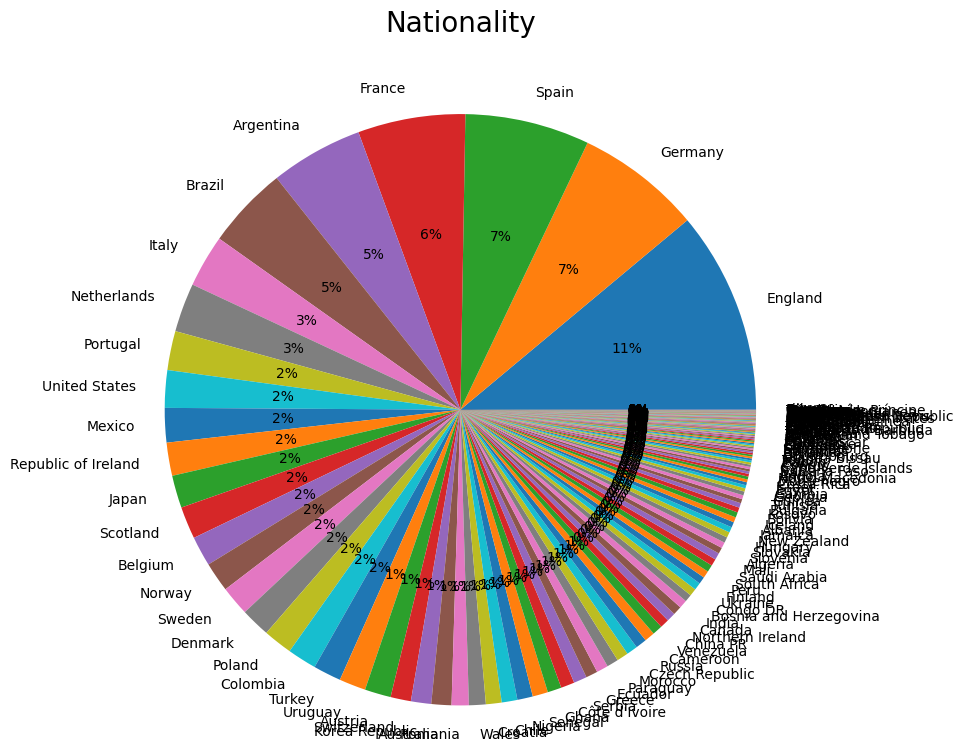

In [ ]:
df['Nationality'].value_counts().plot.pie(autopct='%1.0f%%', radius=2, ylabel='')
plt.title('Nationality', y=1.5, fontsize=20)
plt.show()

In [ ]:
df['Nationality'].nunique()

167

In [ ]:
counts = df['Nationality'].value_counts() / df.shape[0]
idx = counts[counts.lt(0.02)].index

df.loc[df['Nationality'].isin(idx), 'Nationality'] = 'Others'

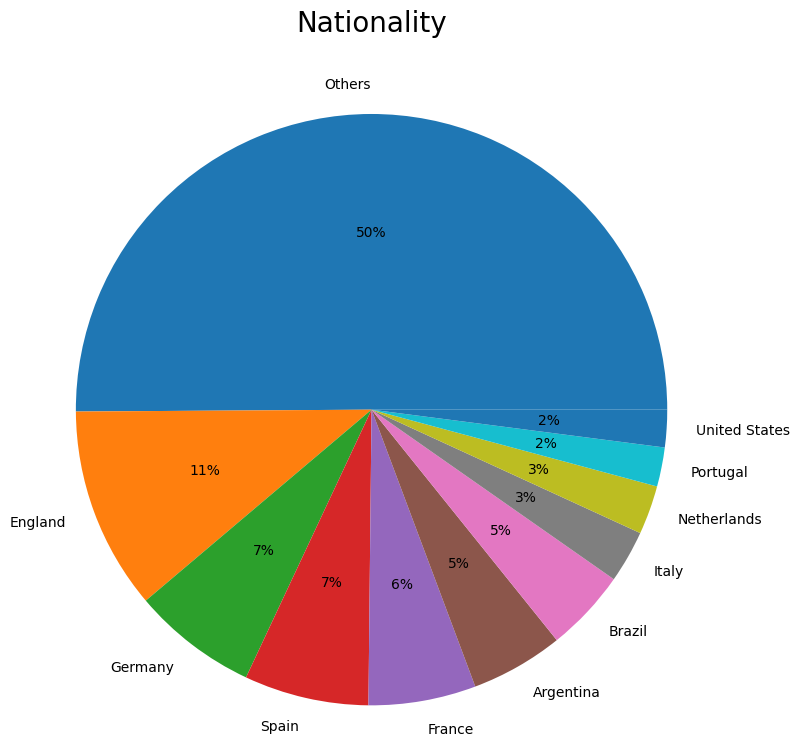

In [ ]:
df['Nationality'].value_counts().plot.pie(autopct='%1.0f%%', radius=2, ylabel='')
plt.title('Nationality', y=1.5, fontsize=20)
plt.show()

In [ ]:
df['Nationality'].nunique()

11

In [ ]:
def convert_currency_to_number(x):
    output = x.replace('€','')
    if 'M' in x:
        output = output.replace('M','')
        output = float(output) * 1e6
    elif 'K' in x:
        output = output.replace('K','')
        output = float(output) * 1e3
    output = int(output)
    return output

In [ ]:
df['Value'].head()

0    €107.5M
1       €93M
2     €44.5M
3    €125.5M
4       €37M
Name: Value, dtype: object

In [ ]:
df['Value'] = df['Value'].apply(convert_currency_to_number)
df['Wage'] = df['Wage'].apply(convert_currency_to_number)

In [ ]:
df.head()

,Age,Nationality,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Work_Rate,Body_Type,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,DefensiveAwareness
0,26,Portugal,88,89,107500000,250000,Right,3.0,3.0,4.0,High/ High,Unique,18.0,179cm,69kg,87.0,83.0,64.0,91.0,87.0,83.0,87.0,87.0,88.0,87.0,77.0,73.0,80.0,91.0,79.0,89.0,73.0,91.0,70.0,89.0,78.0,66.0,87.0,90.0,91.0,87.0,73.0,65.0,12.0,14.0,15.0,8.0,14.0,CAM,88.0,72.0
1,26,Germany,87,88,93000000,140000,Right,4.0,4.0,3.0,High/ Medium,Unique,8.0,189cm,82kg,75.0,82.0,86.0,86.0,69.0,84.0,76.0,75.0,84.0,87.0,78.0,83.0,76.0,88.0,71.0,85.0,79.0,88.0,88.0,86.0,81.0,86.0,85.0,84.0,60.0,82.0,85.0,77.0,13.0,8.0,15.0,11.0,9.0,CM,87.0,74.0
2,34,Others,88,88,44500000,135000,Right,5.0,4.0,3.0,High/ Medium,Unique,9.0,182cm,83kg,80.0,93.0,84.0,83.0,90.0,83.0,86.0,82.0,77.0,86.0,76.0,69.0,75.0,92.0,78.0,89.0,69.0,78.0,85.0,88.0,87.0,41.0,91.0,84.0,83.0,87.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,ST,88.0,42.0
3,30,Others,91,91,125500000,350000,Right,4.0,5.0,4.0,High/ High,Unique,17.0,181cm,70kg,94.0,82.0,55.0,94.0,82.0,88.0,85.0,83.0,93.0,91.0,76.0,76.0,79.0,91.0,78.0,91.0,63.0,89.0,74.0,91.0,76.0,66.0,88.0,94.0,83.0,89.0,65.0,53.0,15.0,13.0,5.0,10.0,13.0,CM,91.0,68.0
4,29,Argentina,84,84,37000000,45000,Left,2.0,3.0,4.0,High/ High,Stocky (170-185),19.0,172cm,69kg,87.0,66.0,58.0,82.0,68.0,87.0,88.0,75.0,78.0,88.0,77.0,76.0,83.0,83.0,90.0,82.0,63.0,90.0,80.0,81.0,84.0,79.0,81.0,82.0,76.0,87.0,84.0,82.0,8.0,14.0,13.0,13.0,14.0,FB,84.0,80.0


In [ ]:
def heigth_or_weight_to_num(x):
    return int(x[:-2])

In [ ]:
df['Height'] = df['Height'].apply(heigth_or_weight_to_num)
df['Weight'] = df['Weight'].apply(heigth_or_weight_to_num)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15802 entries, 0 to 15801
Data columns (total 51 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       15802 non-null  int64  
 1   Nationality               15802 non-null  object 
 2   Overall                   15802 non-null  int64  
 3   Potential                 15802 non-null  int64  
 4   Value                     15802 non-null  int64  
 5   Wage                      15802 non-null  int64  
 6   Preferred_Foot            15802 non-null  object 
 7   International_Reputation  15802 non-null  float64
 8   Weak_Foot                 15802 non-null  float64
 9   Skill_Moves               15802 non-null  float64
 10  Work_Rate                 15802 non-null  object 
 11  Body_Type                 15802 non-null  object 
 12  Jersey_Number             15802 non-null  float64
 13  Height                    15802 non-null  int64  
 14  Weight

In [ ]:
df['Preferred_Foot'].unique()

array(['Right', 'Left'], dtype=object)

In [ ]:
from sklearn.preprocessing import OrdinalEncoder

foot_oe = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)
foot_oe.fit(df['Preferred_Foot'].values.reshape(-1, 1))
df['Preferred_Foot'] = foot_oe.transform(df['Preferred_Foot'].values.reshape(-1, 1))
df['Preferred_Foot'].head()

0    1.0
1    1.0
2    1.0
3    1.0
4    0.0
Name: Preferred_Foot, dtype: float64

In [ ]:
def convert_work_rate(x):
    attack_work_rate, defend_work_rate = x.split('/')
    return attack_work_rate, defend_work_rate
    

In [ ]:
df['Work_Rate'].head()

0      High/ High
1    High/ Medium
2    High/ Medium
3      High/ High
4      High/ High
Name: Work_Rate, dtype: object

In [ ]:
df[['Attack_Work_Rate', 'Defend_Work_Rate']] = df['Work_Rate'].str.split('/ ', expand=True)
df.drop(columns='Work_Rate', inplace=True)
df.head()

,Age,Nationality,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Body_Type,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,DefensiveAwareness,Attack_Work_Rate,Defend_Work_Rate
0,26,Portugal,88,89,107500000,250000,1.0,3.0,3.0,4.0,Unique,18.0,179,69,87.0,83.0,64.0,91.0,87.0,83.0,87.0,87.0,88.0,87.0,77.0,73.0,80.0,91.0,79.0,89.0,73.0,91.0,70.0,89.0,78.0,66.0,87.0,90.0,91.0,87.0,73.0,65.0,12.0,14.0,15.0,8.0,14.0,CAM,88.0,72.0,High,High
1,26,Germany,87,88,93000000,140000,1.0,4.0,4.0,3.0,Unique,8.0,189,82,75.0,82.0,86.0,86.0,69.0,84.0,76.0,75.0,84.0,87.0,78.0,83.0,76.0,88.0,71.0,85.0,79.0,88.0,88.0,86.0,81.0,86.0,85.0,84.0,60.0,82.0,85.0,77.0,13.0,8.0,15.0,11.0,9.0,CM,87.0,74.0,High,Medium
2,34,Others,88,88,44500000,135000,1.0,5.0,4.0,3.0,Unique,9.0,182,83,80.0,93.0,84.0,83.0,90.0,83.0,86.0,82.0,77.0,86.0,76.0,69.0,75.0,92.0,78.0,89.0,69.0,78.0,85.0,88.0,87.0,41.0,91.0,84.0,83.0,87.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,ST,88.0,42.0,High,Medium
3,30,Others,91,91,125500000,350000,1.0,4.0,5.0,4.0,Unique,17.0,181,70,94.0,82.0,55.0,94.0,82.0,88.0,85.0,83.0,93.0,91.0,76.0,76.0,79.0,91.0,78.0,91.0,63.0,89.0,74.0,91.0,76.0,66.0,88.0,94.0,83.0,89.0,65.0,53.0,15.0,13.0,5.0,10.0,13.0,CM,91.0,68.0,High,High
4,29,Argentina,84,84,37000000,45000,0.0,2.0,3.0,4.0,Stocky (170-185),19.0,172,69,87.0,66.0,58.0,82.0,68.0,87.0,88.0,75.0,78.0,88.0,77.0,76.0,83.0,83.0,90.0,82.0,63.0,90.0,80.0,81.0,84.0,79.0,81.0,82.0,76.0,87.0,84.0,82.0,8.0,14.0,13.0,13.0,14.0,FB,84.0,80.0,High,High


In [ ]:
work_rate_oe = OrdinalEncoder(categories=[['Low', 'Medium', 'High']],
                              handle_unknown='use_encoded_value', unknown_value=-1)
df['Defend_Work_Rate'] = work_rate_oe.fit_transform(df['Defend_Work_Rate'].values.reshape(-1,1))
df['Attack_Work_Rate'] = work_rate_oe.fit_transform(df['Attack_Work_Rate'].values.reshape(-1,1))
df.head()

,Age,Nationality,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Body_Type,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,DefensiveAwareness,Attack_Work_Rate,Defend_Work_Rate
0,26,Portugal,88,89,107500000,250000,1.0,3.0,3.0,4.0,Unique,18.0,179,69,87.0,83.0,64.0,91.0,87.0,83.0,87.0,87.0,88.0,87.0,77.0,73.0,80.0,91.0,79.0,89.0,73.0,91.0,70.0,89.0,78.0,66.0,87.0,90.0,91.0,87.0,73.0,65.0,12.0,14.0,15.0,8.0,14.0,CAM,88.0,72.0,2.0,2.0
1,26,Germany,87,88,93000000,140000,1.0,4.0,4.0,3.0,Unique,8.0,189,82,75.0,82.0,86.0,86.0,69.0,84.0,76.0,75.0,84.0,87.0,78.0,83.0,76.0,88.0,71.0,85.0,79.0,88.0,88.0,86.0,81.0,86.0,85.0,84.0,60.0,82.0,85.0,77.0,13.0,8.0,15.0,11.0,9.0,CM,87.0,74.0,2.0,1.0
2,34,Others,88,88,44500000,135000,1.0,5.0,4.0,3.0,Unique,9.0,182,83,80.0,93.0,84.0,83.0,90.0,83.0,86.0,82.0,77.0,86.0,76.0,69.0,75.0,92.0,78.0,89.0,69.0,78.0,85.0,88.0,87.0,41.0,91.0,84.0,83.0,87.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,ST,88.0,42.0,2.0,1.0
3,30,Others,91,91,125500000,350000,1.0,4.0,5.0,4.0,Unique,17.0,181,70,94.0,82.0,55.0,94.0,82.0,88.0,85.0,83.0,93.0,91.0,76.0,76.0,79.0,91.0,78.0,91.0,63.0,89.0,74.0,91.0,76.0,66.0,88.0,94.0,83.0,89.0,65.0,53.0,15.0,13.0,5.0,10.0,13.0,CM,91.0,68.0,2.0,2.0
4,29,Argentina,84,84,37000000,45000,0.0,2.0,3.0,4.0,Stocky (170-185),19.0,172,69,87.0,66.0,58.0,82.0,68.0,87.0,88.0,75.0,78.0,88.0,77.0,76.0,83.0,83.0,90.0,82.0,63.0,90.0,80.0,81.0,84.0,79.0,81.0,82.0,76.0,87.0,84.0,82.0,8.0,14.0,13.0,13.0,14.0,FB,84.0,80.0,2.0,2.0


In [ ]:
from sklearn.preprocessing import OneHotEncoder

ohe = OneHotEncoder(sparse_output=False).fit(df[['Nationality', 'Body_Type']])
encoded_df = pd.DataFrame(data=ohe.transform(df[['Nationality', 'Body_Type']]),
             columns=ohe.get_feature_names_out())

final_df = pd.merge(df.drop(columns=['Nationality', 'Body_Type']), encoded_df, right_index=True, left_index=True)
final_df.head()

,Age,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,DefensiveAwareness,Attack_Work_Rate,Defend_Work_Rate,Nationality_Argentina,Nationality_Brazil,Nationality_England,Nationality_France,Nationality_Germany,Nationality_Italy,Nationality_Netherlands,Nationality_Others,Nationality_Portugal,Nationality_Spain,Nationality_United States,Body_Type_Lean (170-),Body_Type_Lean (170-185),Body_Type_Lean (185+),Body_Type_Normal (170-),Body_Type_Normal (170-185),Body_Type_Normal (185+),Body_Type_Stocky (170-),Body_Type_Stocky (170-185),Body_Type_Stocky (185+),Body_Type_Unique
0,26,88,89,107500000,250000,1.0,3.0,3.0,4.0,18.0,179,69,87.0,83.0,64.0,91.0,87.0,83.0,87.0,87.0,88.0,87.0,77.0,73.0,80.0,91.0,79.0,89.0,73.0,91.0,70.0,89.0,78.0,66.0,87.0,90.0,91.0,87.0,73.0,65.0,12.0,14.0,15.0,8.0,14.0,CAM,88.0,72.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,26,87,88,93000000,140000,1.0,4.0,4.0,3.0,8.0,189,82,75.0,82.0,86.0,86.0,69.0,84.0,76.0,75.0,84.0,87.0,78.0,83.0,76.0,88.0,71.0,85.0,79.0,88.0,88.0,86.0,81.0,86.0,85.0,84.0,60.0,82.0,85.0,77.0,13.0,8.0,15.0,11.0,9.0,CM,87.0,74.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,34,88,88,44500000,135000,1.0,5.0,4.0,3.0,9.0,182,83,80.0,93.0,84.0,83.0,90.0,83.0,86.0,82.0,77.0,86.0,76.0,69.0,75.0,92.0,78.0,89.0,69.0,78.0,85.0,88.0,87.0,41.0,91.0,84.0,83.0,87.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,ST,88.0,42.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,30,91,91,125500000,350000,1.0,4.0,5.0,4.0,17.0,181,70,94.0,82.0,55.0,94.0,82.0,88.0,85.0,83.0,93.0,91.0,76.0,76.0,79.0,91.0,78.0,91.0,63.0,89.0,74.0,91.0,76.0,66.0,88.0,94.0,83.0,89.0,65.0,53.0,15.0,13.0,5.0,10.0,13.0,CM,91.0,68.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,29,84,84,37000000,45000,0.0,2.0,3.0,4.0,19.0,172,69,87.0,66.0,58.0,82.0,68.0,87.0,88.0,75.0,78.0,88.0,77.0,76.0,83.0,83.0,90.0,82.0,63.0,90.0,80.0,81.0,84.0,79.0,81.0,82.0,76.0,87.0,84.0,82.0,8.0,14.0,13.0,13.0,14.0,FB,84.0,80.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15802 entries, 0 to 15801
Data columns (total 71 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         15802 non-null  int64  
 1   Overall                     15802 non-null  int64  
 2   Potential                   15802 non-null  int64  
 3   Value                       15802 non-null  int64  
 4   Wage                        15802 non-null  int64  
 5   Preferred_Foot              15802 non-null  float64
 6   International_Reputation    15802 non-null  float64
 7   Weak_Foot                   15802 non-null  float64
 8   Skill_Moves                 15802 non-null  float64
 9   Jersey_Number               15802 non-null  float64
 10  Height                      15802 non-null  int64  
 11  Weight                      15802 non-null  int64  
 12  Crossing                    15802 non-null  float64
 13  Finishing                   158

### feature changes

In [ ]:
df.head()

,Age,Nationality,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Body_Type,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Position,Best_Overall_Rating,DefensiveAwareness,Attack_Work_Rate,Defend_Work_Rate
0,26,Portugal,88,89,107500000,250000,1.0,3.0,3.0,4.0,Unique,18.0,179,69,87.0,83.0,64.0,91.0,87.0,83.0,87.0,87.0,88.0,87.0,77.0,73.0,80.0,91.0,79.0,89.0,73.0,91.0,70.0,89.0,78.0,66.0,87.0,90.0,91.0,87.0,73.0,65.0,12.0,14.0,15.0,8.0,14.0,CAM,88.0,72.0,2.0,2.0
1,26,Germany,87,88,93000000,140000,1.0,4.0,4.0,3.0,Unique,8.0,189,82,75.0,82.0,86.0,86.0,69.0,84.0,76.0,75.0,84.0,87.0,78.0,83.0,76.0,88.0,71.0,85.0,79.0,88.0,88.0,86.0,81.0,86.0,85.0,84.0,60.0,82.0,85.0,77.0,13.0,8.0,15.0,11.0,9.0,CM,87.0,74.0,2.0,1.0
2,34,Others,88,88,44500000,135000,1.0,5.0,4.0,3.0,Unique,9.0,182,83,80.0,93.0,84.0,83.0,90.0,83.0,86.0,82.0,77.0,86.0,76.0,69.0,75.0,92.0,78.0,89.0,69.0,78.0,85.0,88.0,87.0,41.0,91.0,84.0,83.0,87.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,ST,88.0,42.0,2.0,1.0
3,30,Others,91,91,125500000,350000,1.0,4.0,5.0,4.0,Unique,17.0,181,70,94.0,82.0,55.0,94.0,82.0,88.0,85.0,83.0,93.0,91.0,76.0,76.0,79.0,91.0,78.0,91.0,63.0,89.0,74.0,91.0,76.0,66.0,88.0,94.0,83.0,89.0,65.0,53.0,15.0,13.0,5.0,10.0,13.0,CM,91.0,68.0,2.0,2.0
4,29,Argentina,84,84,37000000,45000,0.0,2.0,3.0,4.0,Stocky (170-185),19.0,172,69,87.0,66.0,58.0,82.0,68.0,87.0,88.0,75.0,78.0,88.0,77.0,76.0,83.0,83.0,90.0,82.0,63.0,90.0,80.0,81.0,84.0,79.0,81.0,82.0,76.0,87.0,84.0,82.0,8.0,14.0,13.0,13.0,14.0,FB,84.0,80.0,2.0,2.0


In [ ]:
overal = final_df["Best_Overall_Rating"]
other_rates = final_df.loc[:, "Crossing":"DefensiveAwareness"].drop(columns=["Best_Overall_Rating", "Best_Position"])

In [ ]:
final_df[other_rates.columns.to_list()] = other_rates.div(overal, axis=0)

In [ ]:
final_df.describe()

,Age,Overall,Potential,Value,Wage,Preferred_Foot,International_Reputation,Weak_Foot,Skill_Moves,Jersey_Number,Height,Weight,Crossing,Finishing,HeadingAccuracy,ShortPassing,Volleys,Dribbling,Curve,FKAccuracy,LongPassing,BallControl,Acceleration,SprintSpeed,Agility,Reactions,Balance,ShotPower,Jumping,Stamina,Strength,LongShots,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Best_Overall_Rating,DefensiveAwareness,Attack_Work_Rate,Defend_Work_Rate,Nationality_Argentina,Nationality_Brazil,Nationality_England,Nationality_France,Nationality_Germany,Nationality_Italy,Nationality_Netherlands,Nationality_Others,Nationality_Portugal,Nationality_Spain,Nationality_United States,Body_Type_Lean (170-),Body_Type_Lean (170-185),Body_Type_Lean (185+),Body_Type_Normal (170-),Body_Type_Normal (170-185),Body_Type_Normal (185+),Body_Type_Stocky (170-),Body_Type_Stocky (170-185),Body_Type_Stocky (185+),Body_Type_Unique
count,15802.000000,15802.000000,15802.000000,1.580200e+04,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.00000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000,15802.000000
mean,25.471333,67.532844,72.635046,3.439972e+06,11106.391596,0.753702,1.142514,3.004240,2.476775,20.579294,181.439122,75.216175,0.756256,0.706754,0.785218,0.890855,0.658320,0.852742,0.731009,0.649624,0.803781,0.891518,0.967097,0.968382,0.957187,0.923733,0.953945,0.881265,0.964901,0.940611,0.967768,0.721858,0.840505,0.696010,0.771117,0.818541,0.732725,0.884418,0.715486,0.681951,0.231878,0.228981,0.227027,0.229833,0.233169,68.520314,0.698311,1.270029,1.096760,0.05069,0.045058,0.110745,0.058727,0.068472,0.028667,0.026705,0.501013,0.021390,0.068093,0.020440,0.023605,0.210796,0.102392,0.032717,0.339514,0.221871,0.006138,0.032907,0.021326,0.008733
std,4.913102,6.399449,5.636952,8.309940e+06,21258.618424,0.430868,0.444293,0.680295,0.787214,17.782061,6.886395,7.147578,0.241751,0.270207,0.234041,0.173013,0.241943,0.246439,0.245420,0.237592,0.186288,0.207365,0.225419,0.220766,0.212798,0.068476,0.218992,0.158730,0.179403,0.213973,0.179041,0.259694,0.228830,0.290699,0.264649,0.168370,0.216147,0.126489,0.302145,0.299272,0.252684,0.242051,0.237887,0.244843,0.257108,6.207526,0.282127,0.547519,0.532178,0.21937,0.207437,0.313827,0.235120,0.252563,0.166875,0.161226,0.500015,0.144684,0.251913,0.141506,0.151819,0.407887,0.303173,0.177902,0.473559,0.415518,0.078110,0.178399,0.144475,0.093045
min,16.000000,47.000000,47.000000,0.000000e+00,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,155.000000,49.000000,0.097222,0.042254,0.079365,0.121212,0.056338,0.072464,0.084507,0.055556,0.136364,0.112500,0.196970,0.214286,0.256757,0.500000,0.270270,0.285714,0.363636,0.183099,0.318841,0.052632,0.135802,0.065574,0.041096,0.138889,0.111111,0.171429,0.092105,0.086957,0.013158,0.013158,0.013158,0.013158,0.013158,47.000000,0.046875,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,21.000000,63.000000,69.000000,6.250000e+05,2000.000000,1.000000,1.000000,3.000000,2.000000,8.000000,176.000000,70.000000,0.627119,0.506

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
onehot_column_names = list(ohe.get_feature_names_out()) + ['Preferred_Foot', 'Best_Position']
standard_scaling_columns = list(set(final_df.columns) - set(onehot_column_names))
final_df[standard_scaling_columns] = scaler.fit_transform(final_df[standard_scaling_columns])
final_df[standard_scaling_columns].describe()


,Crossing,LongShots,SlidingTackle,Weak_Foot,Stamina,Jersey_Number,Strength,FKAccuracy,GKHandling,DefensiveAwareness,Value,Reactions,Age,Overall,ShotPower,Aggression,GKDiving,Weight,GKReflexes,Best_Overall_Rating,Jumping,Composure,Interceptions,Height,GKPositioning,Balance,Attack_Work_Rate,International_Reputation,Volleys,GKKicking,Dribbling,Defend_Work_Rate,Vision,Skill_Moves,StandingTackle,BallControl,Positioning,Curve,Agility,Wage,HeadingAccuracy,SprintSpeed,LongPassing,Potential,Penalties,Acceleration,Finishing,ShortPassing
count,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,15802.000000,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,15802.000000,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,1.580200e+04,15802.000000,1.580200e+04,1.580200e+04,15802.000000
mean,8.633351e-17,5.755567e-17,-7.194459e-17,2.877784e-16,5.755567e-17,-2.158338e-17,2.302227e-16,0.000000,-8.633351e-17,1.295003e-16,-2.877784e-17,1.640337e-15,1.151113e-16,3.453340e-16,-4.028897e-16,-1.438892e-16,8.633351e-17,7.770015e-16,-8.633351e-17,5.755567e-17,-1.438892e-17,-2.014448e-16,0.000000,9.784464e-16,5.755567e-17,5.180010e-16,-5.755567e-17,-5.755567e-17,-5.755567e-17,5.755567e-17,-8.633351e-17,1.079169e-16,-1.151113e-16,2.302227e-16,-2.590005e-16,2.302227e-16,-3.741119e-16,1.726670e-16,2.877784e-16,-5.755567e-17,-4.316675e-17,-1.295003e-16,-5.755567e-17,9.208907e-16,0.000000,4.460564e-16,-8.633351e-17,0.000000
std,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032e+00,1.000032,1.000032e+00,1.000032e+00,1.000032
min,-2.726171e+00,-2.577060e+00,-1.988205e+00,-2.946228e+00,-3.540333e+00,-1.101105e+00,-3.624585e+00,-2.500448,-8.916721e-01,-2.309091e+00,-4.139718e-01,-6.188234e+00,-1.927832e+00,-3.208635e+00,-3.752085e+00,-3.079687e+00,-8.656129e-01,-3.667956e+00,-8.557445e-01,-3.466920e+00,-3.351581e+00,-5.636961e+00,-2.168759,-3.839448e+00,-8.849847e-01,-3.122018e+00,-2.319679e+00,-3.207750e-01,-2.488195e+00,-8.990630e-01,-3.166313e+00,-2.060955e+00,-4.036785e+00,-1.876010e+00,-2.063249e+00,-3.756874e+00,-2.758540e+00,-2.634347e+00,-3.291631e+00,-5.224584e-01,-3.016036e+00,-3.415933e+00,-3.582827e+00,-4.547823e+00,-2.875979,-3.416531e+00,-2.459302e+00,-4.448620
25%,-5.341917e-01,-6.513602e-01,-1.013036e+00,-6.232746e-03,-3.540092e-01,-7.074372e-01,-5.933462e-01,-0.682061,-4.527208e-01,-8.998602e-01,-3.387583e-01,-5.088644e-01,-9.101123e-01,-7.083403e-01,-7.128587e-01,-6.140332e-01,-4.520829e-01,-7.298052e-01,-4.493293e-01,-7.282220e-01,-5.882267e-01,-4.565854e-01,-1.008747,-7.898608e-01,-4.550496e-01,-5.908338e-01,-4.932019e-01,-3.207750e-01,-7.087774e-01,-4.565569e-01,-1.292297e-01,-1.818245e-01,-5.817900e-01,-6.056677e-01,-9.581273e-01,-2.022691e-02,-3.946866e-01,-6.068113e-01,-5.372848e-01,-4.283759e-01,-4.018280e-01,-5.211528e-01,-5.051682e-01,-6.448807e-01,-0.586031,-5.472054e-01,-7.396650e-01,-0.114953
50%,3.488152e-01,3.601523e-01,4.570518e-01,-6.232746e-03,2.045370e-01,-2.012931e-01,7.554671e-02,0.013276,-2.873894e-01,4.195244e-01,-2.575277e-01,1.237046e-01,-9.593688e-02,-8.326667e-02,2.372299e-01,2.536722e-01,-2.894910e-01,-3.024549e-02,-2.895348e-01,-8.382250e-02,6

## MODEL TRAINING

In [ ]:
from sklearn.model_selection import train_test_split

y = df['Best_Position']
X = final_df.drop(columns='Best_Position')

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=14, stratify=y)
print(X_train.shape)
print(X_test.shape)

(11851, 70)
(3951, 70)


In [ ]:
# from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier(criterion='gini', max_depth=10, min_samples_leaf=10)
model.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=10, min_samples_leaf=10)

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
from sklearn.metrics import f1_score
print('Macro F1-score is %.2f' %f1_score(y_test, y_pred, average='macro'))

Macro F1-score is 0.74


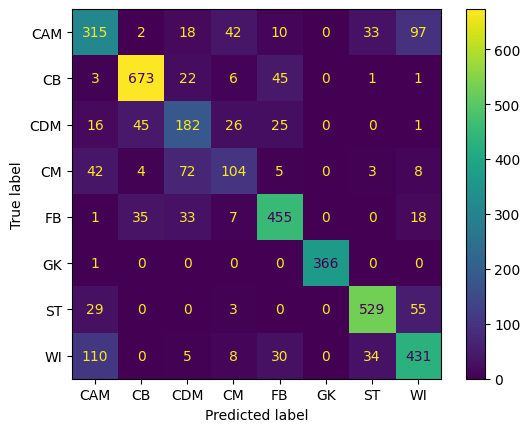

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         CAM       0.61      0.61      0.61       517
          CB       0.89      0.90      0.89       751
         CDM       0.55      0.62      0.58       295
          CM       0.53      0.44      0.48       238
          FB       0.80      0.83      0.81       549
          GK       1.00      1.00      1.00       367
          ST       0.88      0.86      0.87       616
          WI       0.71      0.70      0.70       618

    accuracy                           0.77      3951
   macro avg       0.75      0.74      0.74      3951
weighted avg       0.77      0.77      0.77      3951



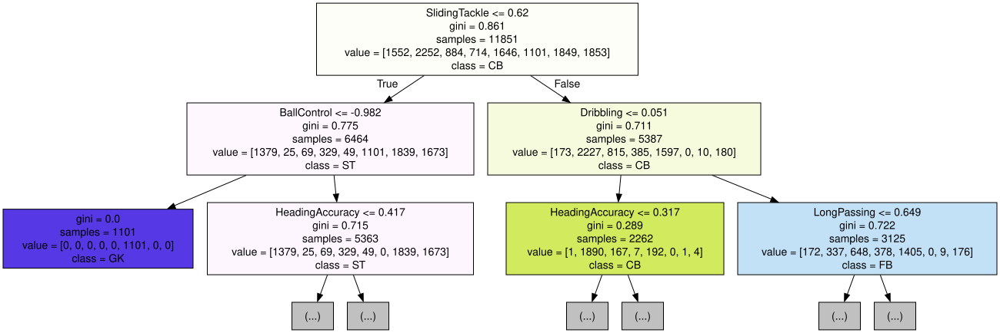

In [ ]:
import graphviz
from sklearn import tree
# DOT data
dot_data = tree.export_graphviz(model, out_file=None,
                                max_depth=2,
                                feature_names=model.feature_names_in_,  
                                class_names=model.classes_,
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data) 
graph

In [ ]:
model.get_depth()

10

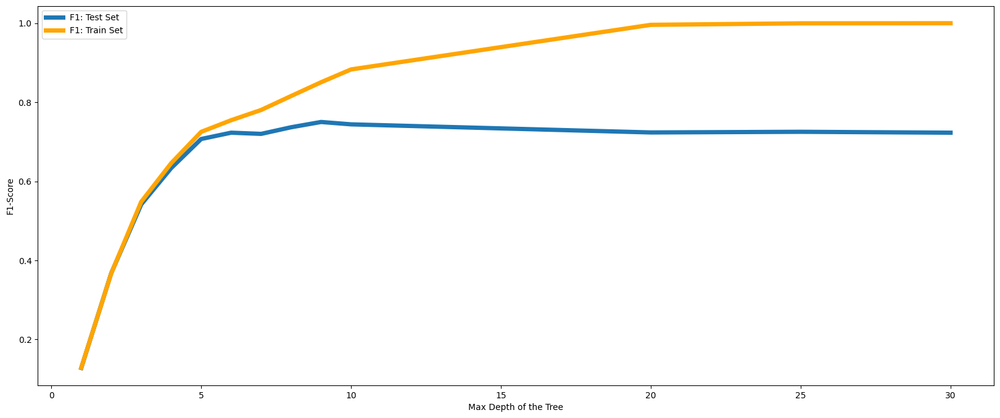

In [ ]:
scores = []
depths_list = [1,2,3,4,5,6,7,8,9,10,20,25,30]
scores = []
scores_train = []
for depth in depths_list:

    # Create the model
    model = DecisionTreeClassifier(max_depth=depth)
    model.fit(X_train, y_train)
    predictions_train = model.predict(X_train)
    F1_train = f1_score(y_train, predictions_train, average='macro')
    scores_train.append(F1_train)

    predictions = model.predict(X_test)
    F1 = f1_score(y_test, predictions, average='macro')
    scores.append(F1)

    
# Plot the results
plt.figure(figsize=(20,8))
plt.plot(depths_list,scores,lw=5)
plt.plot(depths_list,scores_train,lw=5,color='orange')
plt.xlabel('Max Depth of the Tree')
plt.ylabel('F1-Score')
plt.legend(['F1: Test Set','F1: Train Set'])
plt.show()


In [ ]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=50, criterion='entropy',max_depth=10)
model.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=10, n_estimators=50)

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
from sklearn.metrics import f1_score
print('Macro F1-score is %.2f' %f1_score(y_test, y_pred, average='macro'))

Macro F1-score is 0.81


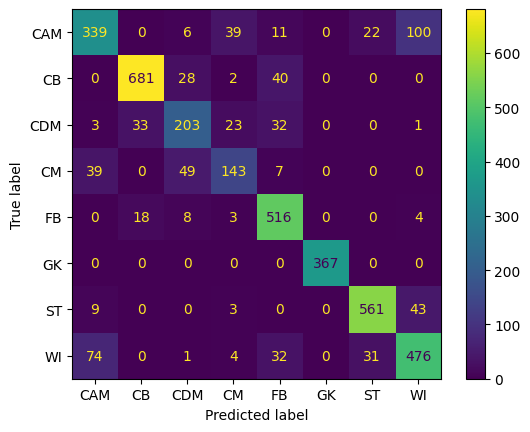

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, y_pred)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         CAM       0.73      0.66      0.69       517
          CB       0.93      0.91      0.92       751
         CDM       0.69      0.69      0.69       295
          CM       0.66      0.60      0.63       238
          FB       0.81      0.94      0.87       549
          GK       1.00      1.00      1.00       367
          ST       0.91      0.91      0.91       616
          WI       0.76      0.77      0.77       618

    accuracy                           0.83      3951
   macro avg       0.81      0.81      0.81      3951
weighted avg       0.83      0.83      0.83      3951



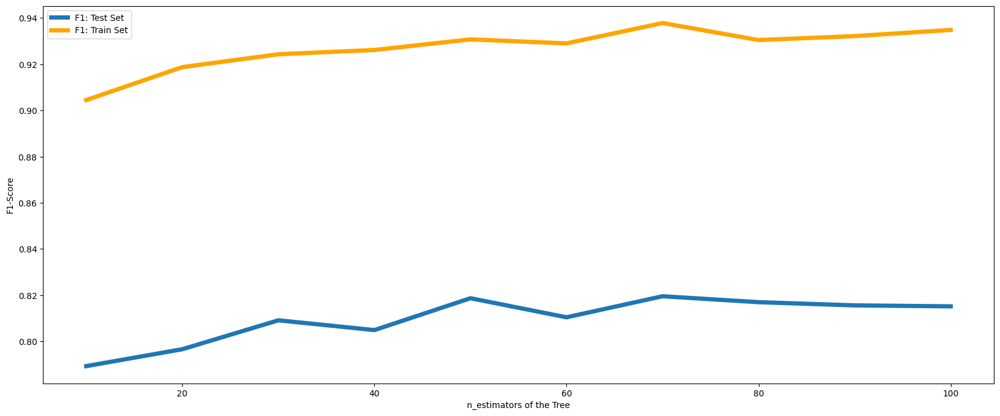

In [ ]:
scores = []
n_estimators = np.arange(start=10, stop=101, step=10)
scores = []
scores_train = []
for n_estimator in n_estimators:

    # Create the model
    model = RandomForestClassifier(n_estimators=n_estimator, max_depth=10)
    model.fit(X_train, y_train)
    predictions_train = model.predict(X_train)
    F1_train = f1_score(y_train, predictions_train, average='macro')
    scores_train.append(F1_train)

    predictions = model.predict(X_test)
    F1 = f1_score(y_test, predictions, average='macro')
    scores.append(F1)

    
# Plot the results
plt.figure(figsize=(20,8))
plt.plot(n_estimators,scores,lw=5)
plt.plot(n_estimators,scores_train,lw=5,color='orange')
plt.xlabel('n_estimators of the Tree')
plt.ylabel('F1-Score')
plt.legend(['F1: Test Set','F1: Train Set'])
plt.show()


## XGBoost

In [ ]:
yoe = OrdinalEncoder().fit(y_train.values.reshape(-1,1))
yoe.transform(y_train.values.reshape(-1,1))
y_train_e, y_test_e = yoe.transform(y_train.values.reshape(-1,1)), yoe.transform(y_test.values.reshape(-1,1))

In [ ]:
# %%timeit

from xgboost import XGBClassifier
model = XGBClassifier(n_estimators=50, eval_metric=f1_score, device="cuda")
model.fit(X_train, y_train_e)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cuda', early_stopping_rounds=None,
              enable_categorical=False,
              eval_metric=<function f1_score at 0x7da19092e200>,
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=50,
              n_jobs=None, num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
y_pred = model.predict(X_test)
print('Macro F1-score is %.2f' %f1_score(y_test_e, y_pred, average='macro'))

Macro F1-score is 0.85


In [ ]:
y_pred = model.predict(X_test)

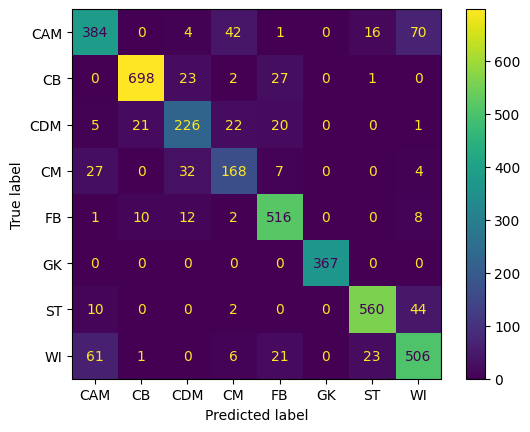

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, yoe.inverse_transform(y_pred.reshape(-1,1)))

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, yoe.inverse_transform(y_pred.reshape(-1,1))))

              precision    recall  f1-score   support

         CAM       0.79      0.74      0.76       517
          CB       0.96      0.93      0.94       751
         CDM       0.76      0.77      0.76       295
          CM       0.69      0.71      0.70       238
          FB       0.87      0.94      0.90       549
          GK       1.00      1.00      1.00       367
          ST       0.93      0.91      0.92       616
          WI       0.80      0.82      0.81       618

    accuracy                           0.87      3951
   macro avg       0.85      0.85      0.85      3951
weighted avg       0.87      0.87      0.87      3951



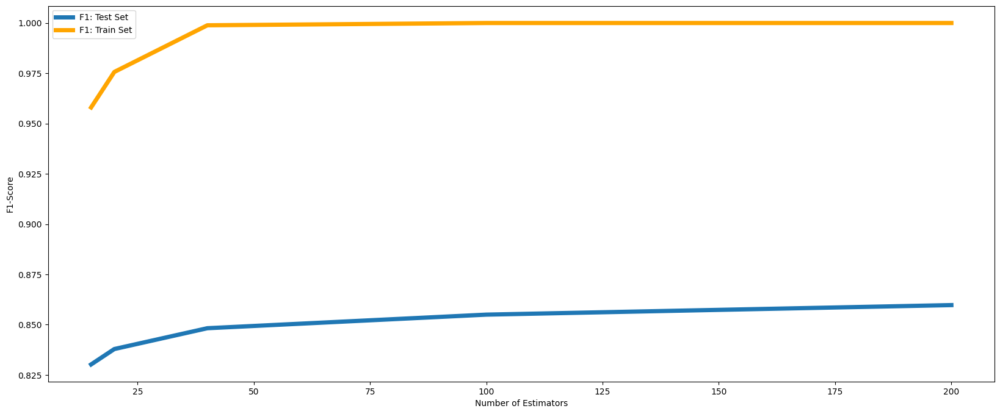

In [ ]:
scores = []
no_estimators = [15,20,40,100,200]
scores = []
scores_train = []
for no_estimator in no_estimators:

    # Create the model
    model = XGBClassifier(n_estimators=no_estimator, device="cuda")
    model.fit(X_train, y_train_e)
    predictions_train = model.predict(X_train)
    F1_train = f1_score(y_train_e, predictions_train, average='macro')
    scores_train.append(F1_train)

    predictions = model.predict(X_test)
    F1 = f1_score(y_test_e, predictions, average='macro')
    scores.append(F1)

    
# Plot the results
plt.figure(figsize=(20,8))
plt.plot(no_estimators,scores,lw=5)
plt.plot(no_estimators,scores_train,lw=5,color='orange')
plt.xlabel('Number of Estimators')
plt.ylabel('F1-Score')
plt.legend(['F1: Test Set','F1: Train Set'])
plt.show()


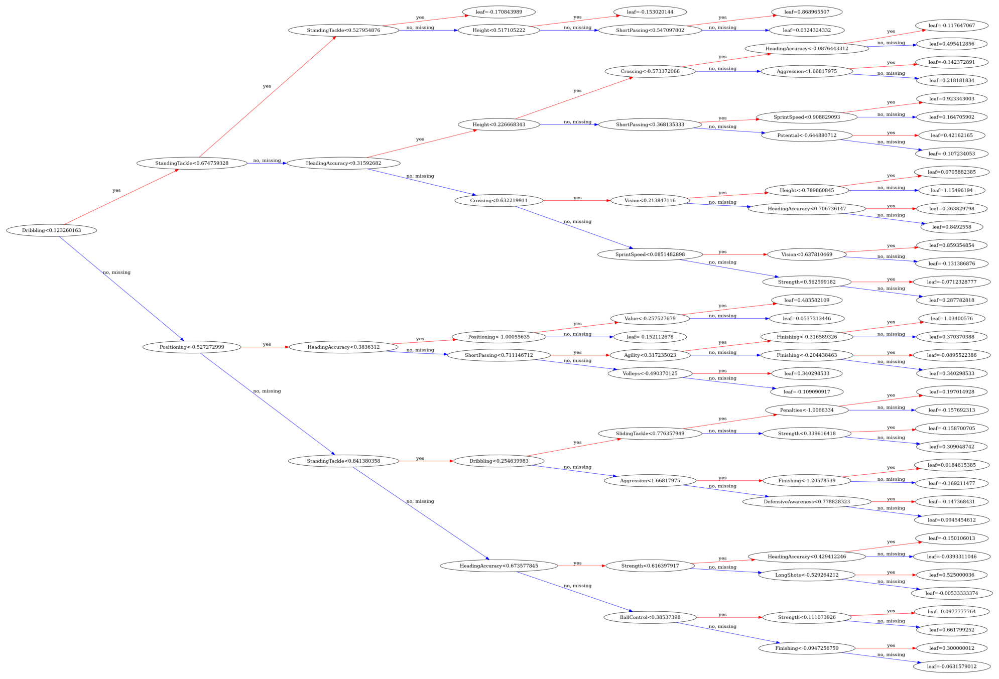

In [ ]:
from xgboost import plot_tree

fig, ax = plt.subplots(figsize=(20,20))
plot_tree(booster=model, num_trees=1, ax=ax, rankdir='LR')
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
# Create the grid search parameter grid and scoring funcitons
# Credit: https://towardsdatascience.com/running-xgboost-on-google-colab-free-gpu-a-case-study-841c90fef101
param_grid = {
    "eta": [0.1, 0.01],
    "subsample": [0.6, 0.8, 1.0],
    "max_depth": [6],
    "n_estimators": [100, 200],
    "colsample_bytree": [0.6, 0.8, 1.0],
    "gamma": [0, 0.3,0.6],
    "device": ["cuda"],
}

kfold = 5
n_iter = 5
scoring = "f1_macro"
grid = RandomizedSearchCV(
    estimator=model, 
    param_distributions=param_grid,
#     cv=kfold,
#     scoring=scoring,
#     n_jobs=-1,
    n_iter=n_iter,
    refit="AUC",
)
# fit grid search
%time best_model = grid.fit(X_train, y_train_e)

CPU times: user 13min 1s, sys: 2.84 s, total: 13min 4s
Wall time: 3min 20s


In [ ]:
y_pred = best_model.predict(X_test)
print('Macro F1-score is %.2f' %f1_score(y_test_e, y_pred, average='macro'))

Macro F1-score is 0.86


In [ ]:
print('Max depth is: %d ' %best_model.best_estimator_.max_depth)
print('Gamma is: %.2f '  %best_model.best_estimator_.gamma)
print(best_model.best_estimator_.get_params())

Max depth is: 6 
Gamma is: 0.30 
{'objective': 'multi:softprob', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 0.6, 'device': 'cuda', 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': 0.3, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 6, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': 100, 'n_jobs': None, 'num_parallel_tree': None, 'random_state': None, 'reg_alpha': None, 'reg_lambda': None, 'sampling_method': None, 'scale_pos_weight': None, 'subsample': 0.8, 'tree_method': None, 'validate_parameters': None, 'verbosity': None, 'eta': 0.1}


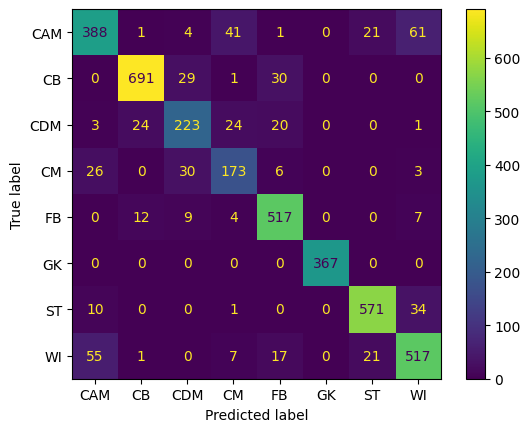

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test, yoe.inverse_transform(y_pred.reshape(-1,1)))

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, yoe.inverse_transform(y_pred.reshape(-1,1))))

              precision    recall  f1-score   support

         CAM       0.80      0.75      0.78       517
          CB       0.95      0.92      0.93       751
         CDM       0.76      0.76      0.76       295
          CM       0.69      0.73      0.71       238
          FB       0.87      0.94      0.91       549
          GK       1.00      1.00      1.00       367
          ST       0.93      0.93      0.93       616
          WI       0.83      0.84      0.83       618

    accuracy                           0.87      3951
   macro avg       0.85      0.86      0.86      3951
weighted avg       0.87      0.87      0.87      3951

